In [15]:
import matplotlib.pyplot as plt
import pandas as pd

co2= pd.read_csv("v50_CO2_excl_short-cycle_org_C_2018.txt", delimiter=';')
co2_1970=pd.read_csv("v50_CO2_excl_short-cycle_org_C_1970.txt", delimiter=';')

# What country has the most polution?


In [20]:
max_co2= co2['emission'].max()
max_info=co2[co2['emission']==max_co2]
print(max_info)

         lat    lon     emission
798909  41.0  122.5  355301000.0


In [17]:
co2_sort=co2.sort_values("emission", ascending=False)
print(co2_sort[:10])

          lat    lon      emission
1789590  -5.3  159.5  8.016030e-07
1219608  26.7 -113.5  1.020840e-06
1933477 -17.3   -1.3  1.882970e-06
1933071 -17.3 -145.5  1.882970e-06
1947916 -18.5 -138.8  1.882970e-06
1910726 -15.4 -145.4  1.882970e-06
1915815 -15.8   -1.1  1.882970e-06
1942975 -18.1 -136.0  1.882970e-06
1844967  -9.7 -139.0  1.882970e-06
1953813 -19.0 -139.0  1.882970e-06


# What country has the least polution?


In [22]:
co2_sort=co2.sort_values("emission", ascending=True)
print(co2_sort[:10], end="\n\n")

max_co2= co2['emission'].max()
max_info=co2[co2['emission']==max_co2]
print(max_info)

          lat    lon      emission
1789590  -5.3  159.5  8.016030e-07
1219608  26.7 -113.5  1.020840e-06
1933477 -17.3   -1.3  1.882970e-06
1933071 -17.3 -145.5  1.882970e-06
1947916 -18.5 -138.8  1.882970e-06
1910726 -15.4 -145.4  1.882970e-06
1915815 -15.8   -1.1  1.882970e-06
1942975 -18.1 -136.0  1.882970e-06
1844967  -9.7 -139.0  1.882970e-06
1953813 -19.0 -139.0  1.882970e-06

         lat    lon     emission
798909  41.0  122.5  355301000.0


# The polution map

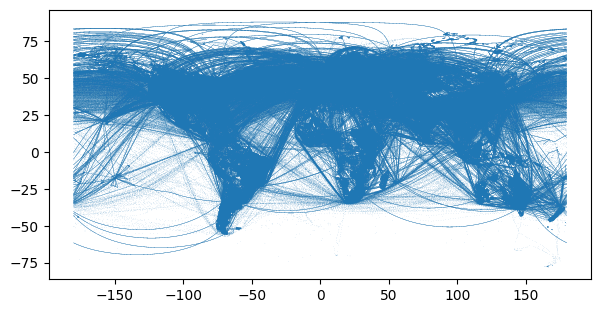

In [23]:
fig = plt.figure()
fig.set_size_inches(7,3.5)
plt.scatter(co2["lon"],co2["lat"],s=0.05,edgecolors='none')
plt.show()

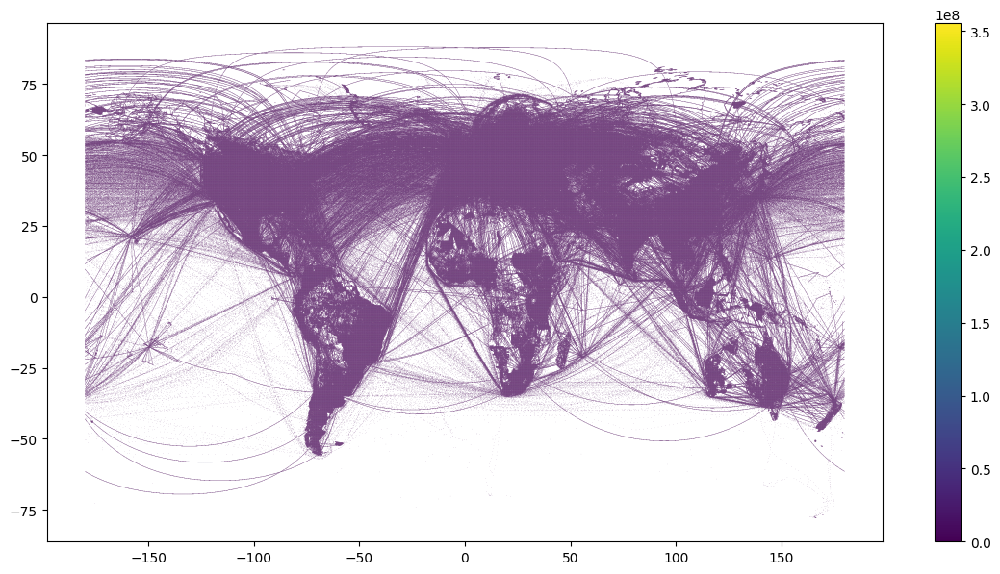

In [25]:
scale = 2
fig = plt.figure()
fig.set_size_inches(7 *2,3.5*2)
cols =plt.scatter(co2["lon"],co2["lat"],c=co2['emission'],s=0.05,edgecolors='none')
plt.colorbar(cols)
plt.show()

In [26]:
import numpy as np

print(co2.emission.value_counts(), end="\n")
print(" min value",np.amin(co2.emission))
print(" max value",np.amax(co2.emission))


emission
347.2490    30310
248.0350    27141
297.6420    22373
396.8560    17280
148.8210    17257
            ...  
86.9979         1
92.7306         1
97.8449         1
91.6624         1
71.6212         1
Name: count, Length: 1215854, dtype: int64
 min value 8.01603e-07
 max value 355301000.0


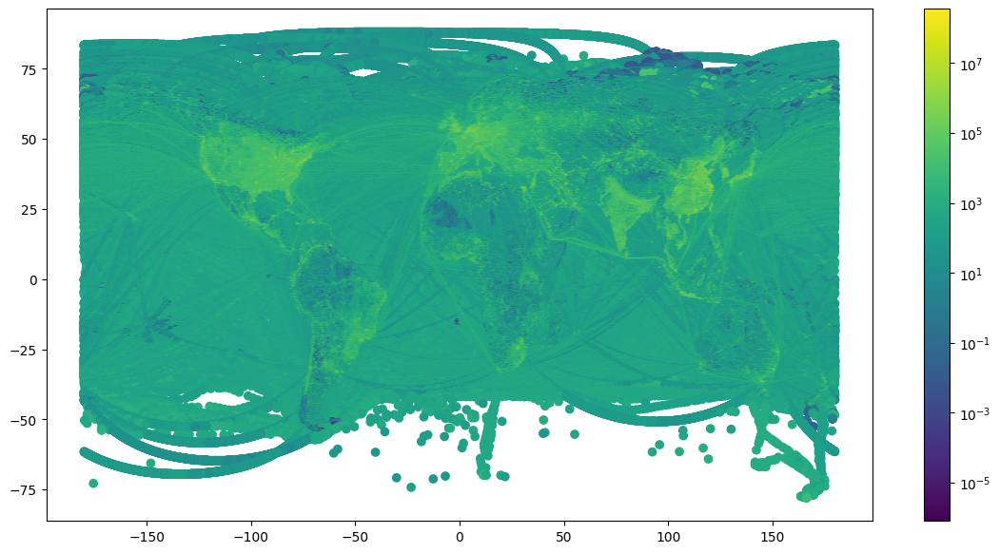

In [27]:
from matplotlib import colors
scale = 2
fig = plt.figure()
fig.set_size_inches(7 *2,3.5*2)
cols =plt.scatter(co2["lon"],co2["lat"],c=co2['emission'], norm=colors.LogNorm())
plt.colorbar(cols)
plt.show()

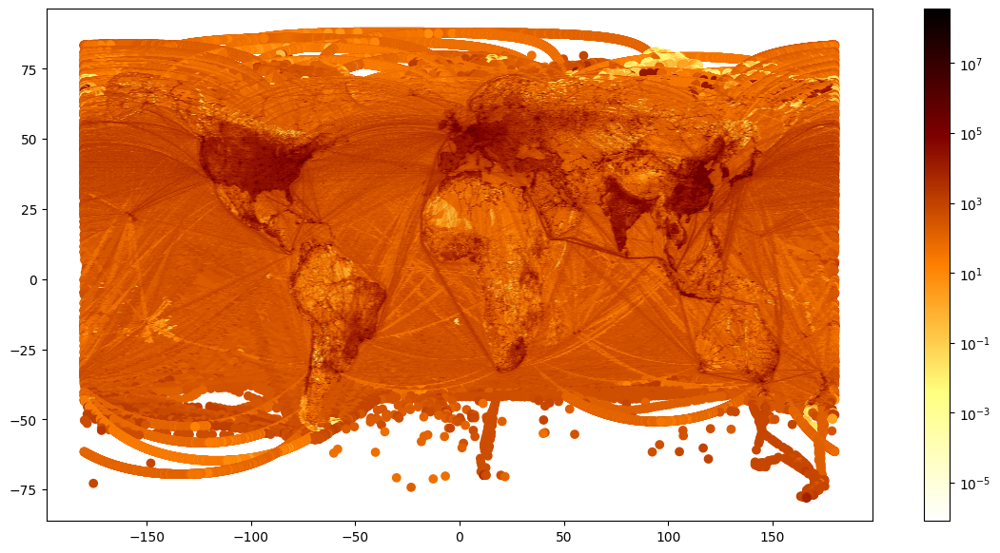

In [28]:
from matplotlib import colors
scale = 2
fig = plt.figure()
fig.set_size_inches(7 *2,3.5*2)
cols =plt.scatter(co2["lon"],co2["lat"],c=co2['emission'], norm=colors.LogNorm(),cmap='afmhot_r')
plt.colorbar(cols)
plt.show()

# Poligonos

In [30]:
import geopandas as gpd
from shapely.geometry import Point

geometry=[Point(xy) for xy in zip(co2['lon'],co2['lat'])]
geodata= gpd.GeoDataFrame(co2,crs="EPSG:4326",geometry=geometry)

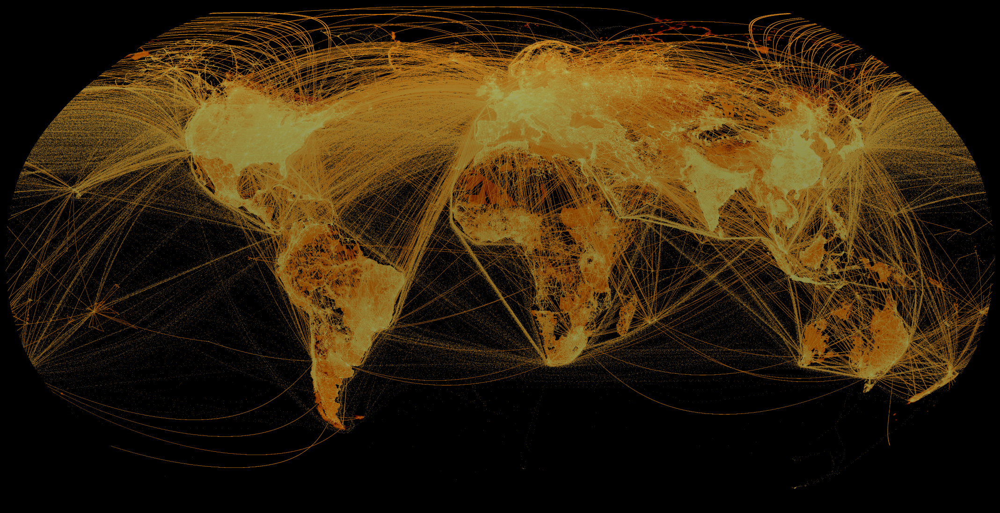

In [35]:
from cartopy import crs as ccrs
scale= 4
fig , ax = plt.subplots(facecolor='black', subplot_kw={'projection':ccrs.Robinson()})
ax.patch.set_facecolor('black')
fig.set_size_inches(7 *scale, 3.5 *scale)
ax=geodata.plot(ax=ax,column='emission', transform= ccrs.PlateCarree(), cmap='afmhot',norm=colors.LogNorm()
                ,s= 0.05*scale,edgecolors='none')

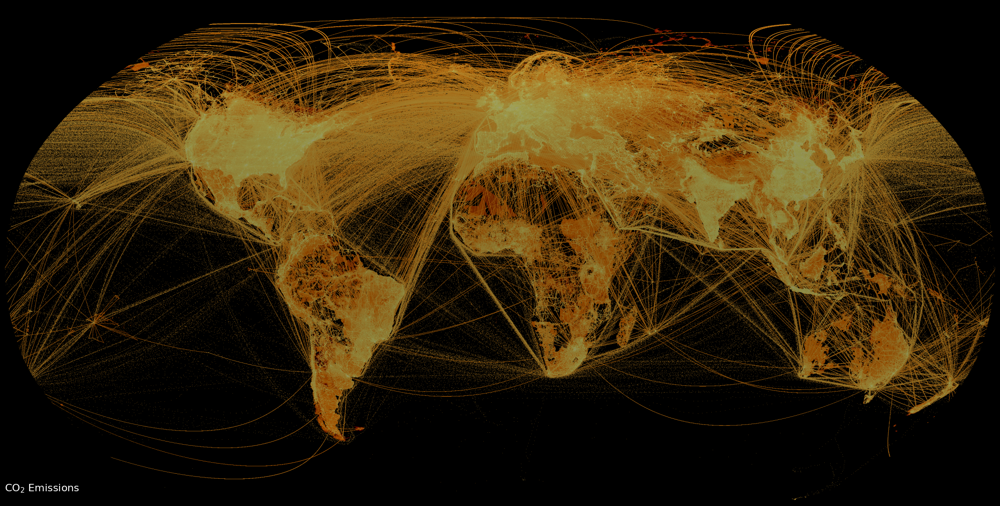

In [37]:
from cartopy import crs as ccrs
scale= 4
fig , ax = plt.subplots(facecolor='black', subplot_kw={'projection':ccrs.Robinson()})
ax.patch.set_facecolor('black')
fig.set_size_inches(7 *scale, 3.5 *scale)
ax=geodata.plot(ax=ax,column='emission', transform= ccrs.PlateCarree(), cmap='afmhot',norm=colors.LogNorm()
                ,s= 0.05*scale,edgecolors='none')
plt.setp(ax.spines.values(), color='black')
plt.setp([ax.get_xticklines(),ax.get_yticklines()], color='black')
ax.set_ylim(-8000000,9000000)

txt=ax.text(0.0,0.02,"CO$_2$ Emissions",size=4*scale, color='white',transform=ax.transAxes)
plt.show()

C:\Users\USUARIO\AppData\Local\Temp\ipykernel_18576\507629811.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  our_cmap=cm.get_cmap('afmhot',11)


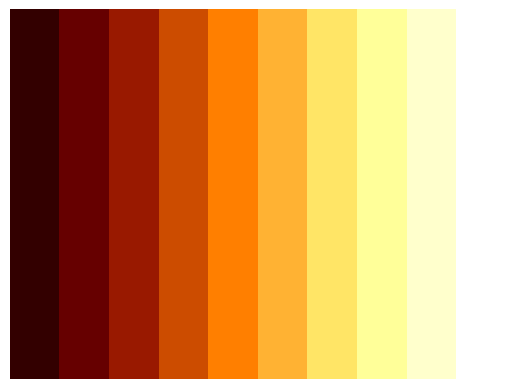

In [38]:
from matplotlib import cm
from matplotlib.colors import ListedColormap

our_cmap=cm.get_cmap('afmhot',11)
newcolors=our_cmap(np.linspace(0,1,11))
newcolors=newcolors[1:]

black = np.array([0.0,0.0,0.0,1.0])
our_cmap=ListedColormap(newcolors)
bounds=[0.0,0.06,6,60,3000,6000,24000,45000,120000]
norm=colors.BoundaryNorm(bounds,our_cmap.N)

gradient=np.linspace(0,1,10)
gradient=np.vstack((gradient,gradient))
plt.imshow(gradient,aspect='auto',cmap=our_cmap)
plt.axis('off')
plt.show()

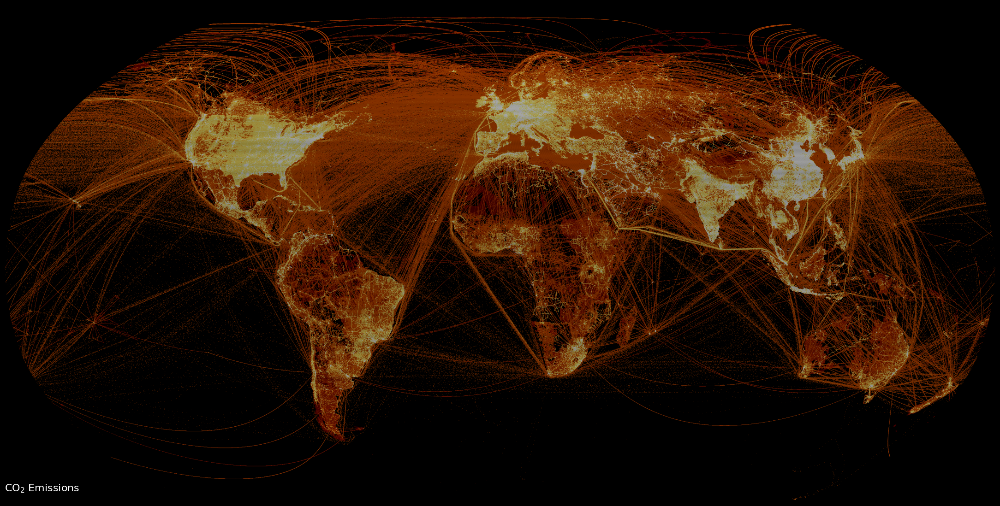

In [41]:
from cartopy import crs as ccrs
scale= 4
fig , ax = plt.subplots(facecolor='black', subplot_kw={'projection':ccrs.Robinson()})
ax.patch.set_facecolor('black')
fig.set_size_inches(7 *scale, 3.5 *scale)
ax=geodata.plot(ax=ax,column='emission', transform= ccrs.PlateCarree(), cmap=our_cmap,norm=norm
                ,s= 0.05*scale,edgecolors='none')
plt.setp(ax.spines.values(), color='black')
plt.setp([ax.get_xticklines(),ax.get_yticklines()], color='black')
ax.set_ylim(-8000000,9000000)

txt=ax.text(0.0,0.02,"CO$_2$ Emissions",size=4*scale, color='white',transform=ax.transAxes)
plt.show()

# Data set 1970 vs 2018


In [44]:
co2_1970=pd.read_csv("v50_CO2_excl_short-cycle_org_C_1970.txt", delimiter=';')
max_co2= co2_1970['emission'].max()
max_info=co2_1970[co2_1970['emission']==max_co2]
print(max_info)

         lat   lon    emission
770452  41.3 -87.3  48394600.0


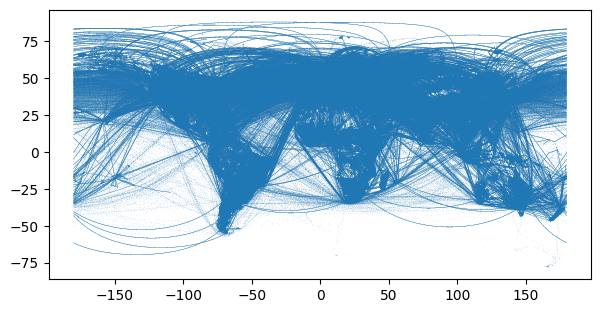

In [45]:
fig = plt.figure()
fig.set_size_inches(7,3.5)
plt.scatter(co2_1970["lon"],co2_1970["lat"],s=0.05,edgecolors='none')
plt.show()

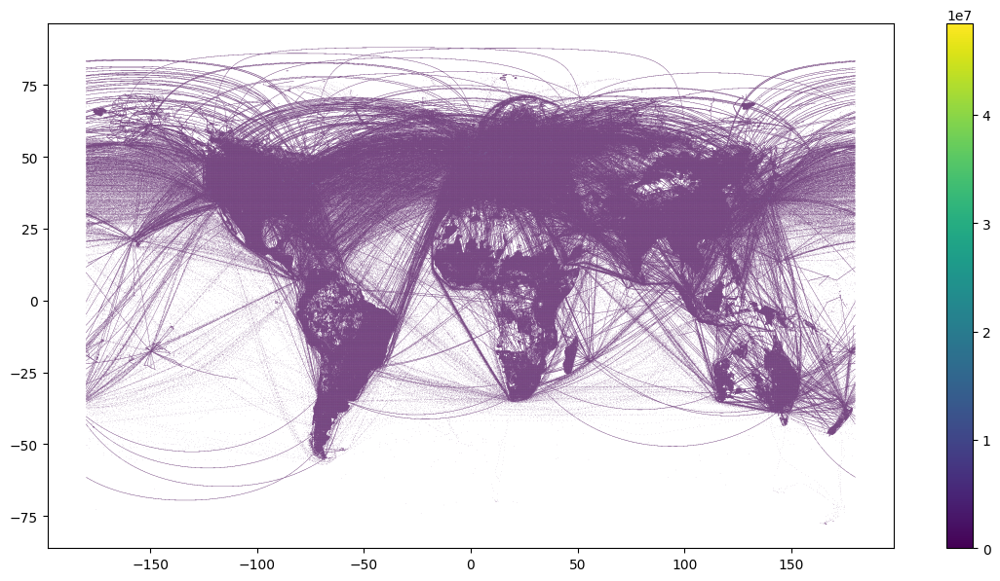

In [46]:
scale = 2
fig = plt.figure()
fig.set_size_inches(7 *2,3.5*2)
cols =plt.scatter(co2_1970["lon"],co2_1970["lat"],c=co2_1970['emission'],s=0.05,edgecolors='none')
plt.colorbar(cols)
plt.show()

In [47]:
import geopandas as gpd
from shapely.geometry import Point

geometry=[Point(xy) for xy in zip(co2_1970['lon'],co2_1970['lat'])]
geodata= gpd.GeoDataFrame(co2_1970,crs="EPSG:4326",geometry=geometry)

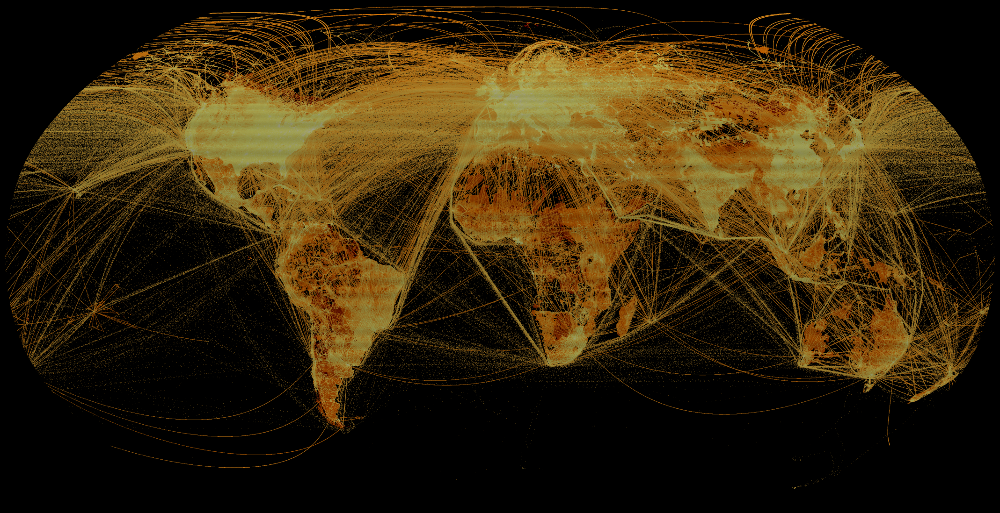

In [48]:
from cartopy import crs as ccrs
scale= 4
fig , ax = plt.subplots(facecolor='black', subplot_kw={'projection':ccrs.Robinson()})
ax.patch.set_facecolor('black')
fig.set_size_inches(7 *scale, 3.5 *scale)
ax=geodata.plot(ax=ax,column='emission', transform= ccrs.PlateCarree(), cmap='afmhot',norm=colors.LogNorm()
                ,s= 0.05*scale,edgecolors='none')

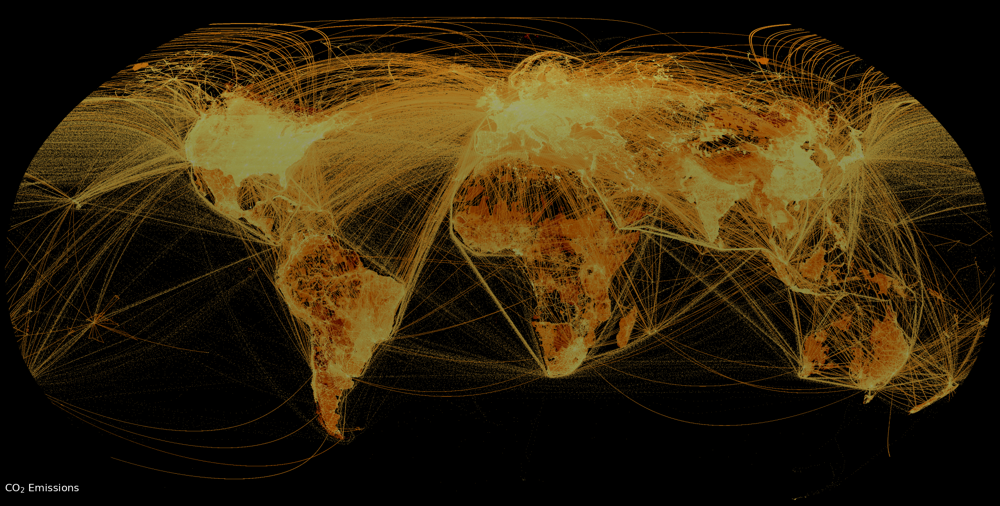

In [49]:
from cartopy import crs as ccrs
scale= 4
fig , ax = plt.subplots(facecolor='black', subplot_kw={'projection':ccrs.Robinson()})
ax.patch.set_facecolor('black')
fig.set_size_inches(7 *scale, 3.5 *scale)
ax=geodata.plot(ax=ax,column='emission', transform= ccrs.PlateCarree(), cmap='afmhot',norm=colors.LogNorm()
                ,s= 0.05*scale,edgecolors='none')
plt.setp(ax.spines.values(), color='black')
plt.setp([ax.get_xticklines(),ax.get_yticklines()], color='black')
ax.set_ylim(-8000000,9000000)

txt=ax.text(0.0,0.02,"CO$_2$ Emissions",size=4*scale, color='white',transform=ax.transAxes)
plt.show()

C:\Users\USUARIO\AppData\Local\Temp\ipykernel_18576\507629811.py:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  our_cmap=cm.get_cmap('afmhot',11)


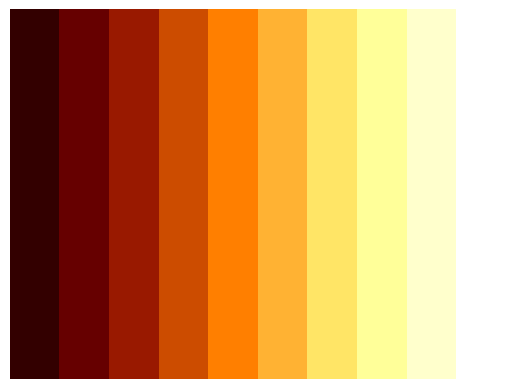

In [50]:
from matplotlib import cm
from matplotlib.colors import ListedColormap

our_cmap=cm.get_cmap('afmhot',11)
newcolors=our_cmap(np.linspace(0,1,11))
newcolors=newcolors[1:]

black = np.array([0.0,0.0,0.0,1.0])
our_cmap=ListedColormap(newcolors)
bounds=[0.0,0.06,6,60,3000,6000,24000,45000,120000]
norm=colors.BoundaryNorm(bounds,our_cmap.N)

gradient=np.linspace(0,1,10)
gradient=np.vstack((gradient,gradient))
plt.imshow(gradient,aspect='auto',cmap=our_cmap)
plt.axis('off')
plt.show()

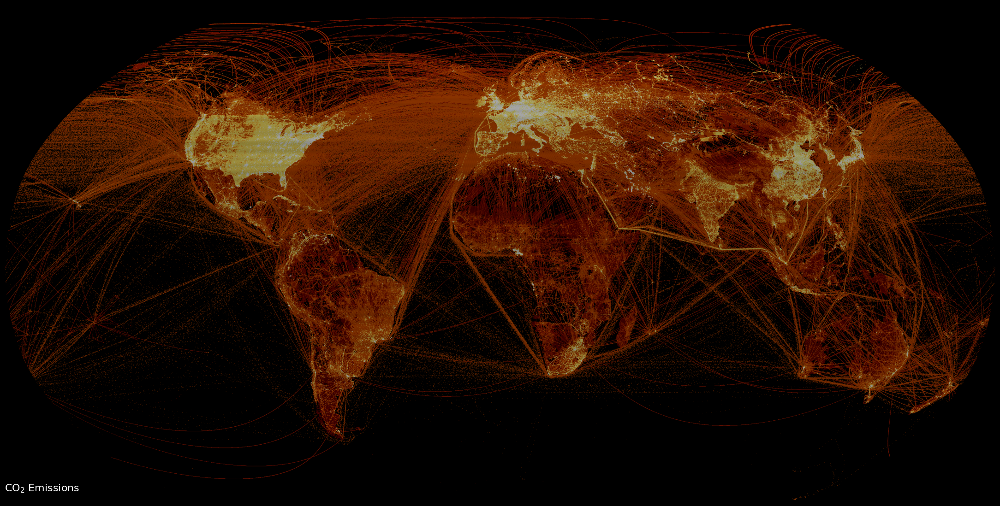

In [51]:
from cartopy import crs as ccrs
scale= 4
fig , ax = plt.subplots(facecolor='black', subplot_kw={'projection':ccrs.Robinson()})
ax.patch.set_facecolor('black')
fig.set_size_inches(7 *scale, 3.5 *scale)
ax=geodata.plot(ax=ax,column='emission', transform= ccrs.PlateCarree(), cmap=our_cmap,norm=norm
                ,s= 0.05*scale,edgecolors='none')
plt.setp(ax.spines.values(), color='black')
plt.setp([ax.get_xticklines(),ax.get_yticklines()], color='black')
ax.set_ylim(-8000000,9000000)

txt=ax.text(0.0,0.02,"CO$_2$ Emissions",size=4*scale, color='white',transform=ax.transAxes)
plt.show()